# Exploratory Data Analysis
This notebook provides the visualization of the ```tfrecords``` created with the ```to_tfrecords.py```. The train, test, and validations tfrecords are represented bellow:

In [19]:
import logging

import tensorflow.compat.v1 as tf
from object_detection.inputs import train_input
from object_detection.protos import input_reader_pb2
from object_detection.builders.dataset_builder import build as build_dataset
from object_detection.utils.config_util import get_configs_from_pipeline_file

In [20]:
def get_dataset(tfrecord_path, label_map='./label_maps/bstld_label_map.pbtxt'):
    """
    Opens a tf record file and create tf dataset
    args:
      - tfrecord_path [str]: path to a tf record file
      - label_map [str]: path the label_map file
    returns:
      - dataset [tf.Dataset]: tensorflow dataset
    """
    input_config = input_reader_pb2.InputReader()
    input_config.label_map_path = label_map
    input_config.tf_record_input_reader.input_path[:] = [tfrecord_path]
    
    dataset = build_dataset(input_config)
    return dataset

In [21]:
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
import numpy as np

%matplotlib inline

In [48]:
def display_instances(tfrecord):
    """
       This function shows an image from the tfrecord with its
       corresponding ground truth bounding boxes and labels.
    """
    # Variables
    name    = tfrecord['filename']
    img     = tfrecord['image'].numpy()
    img_shape = img.shape
    bboxes   = tfrecord['groundtruth_boxes'].numpy()
    classes = tfrecord['groundtruth_classes'].numpy()
    
    #Display the information of the tfrecord
    print('#########################################TFrecord Information#########################################')
    print('Name of the TFrecord: {}'.format(tfrecord['filename']))
    print('The shape of the image is: {}'.format(img_shape))
    print('The are {} boxes in the image:'.format(len(bboxes)))
    print('The are {} objects in the image:'.format(len(classes)))
    
    # Plot the images 
    _, ax = plt.subplots(1,figsize=(20, 10))
    ## color mapping of classes [Red,Green,Blue]
    colormap = {1: [1, 1, 1], ### White Rectangle represents Traffic Light Off
                2: [0, 1, 0], ### Green Rectangle represents Traffic Light Green
                3: [1, 1, 0], ### Yellow Rectangle represents Traffic Light Yellow
                4: [1, 0, 0]} ### Red Rectangle represents Traffic Light Red
    
    ## Add an image and their corresponding bounding boxes
    for cl, bb in zip(classes, bboxes):
        y1, x1, y2, x2 = bb
        y1 = y1*img_shape[0]
        x1 = x1*img_shape[1]
        y2 = y2*img_shape[0]
        x2 = x2*img_shape[1]
        rec = Rectangle((x1, y1), x2- x1, y2-y1, facecolor='none', edgecolor=colormap[cl])
        ax.add_patch(rec)
        
    # Plot the images with its corresponding bounding boxes
    imgplot = plt.imshow(img)
    plt.show()

## Train TFrecord

In [41]:
train_tfrecord = get_dataset("./tfrecords/train/train.tfrecords")

INFO:tensorflow:Reading unweighted datasets: ['./tfrecords/train/train.tfrecords']
INFO:tensorflow:Reading record datasets for input file: ['./tfrecords/train/train.tfrecords']
INFO:tensorflow:Number of filenames to read: 1


#########################################TFrecord Information#########################################
Name of the TFrecord: b'/workspace/label_files/rgb/train/2015-10-05-16-02-30_bag/708598.png'
The shape of the image is: (720, 1280, 3)
The are 4 boxes in the image:
The are 4 objects in the image:
[3 3 3 4]
[3 3 3 4]
[3 3 3 4]
[3 3 3 4]


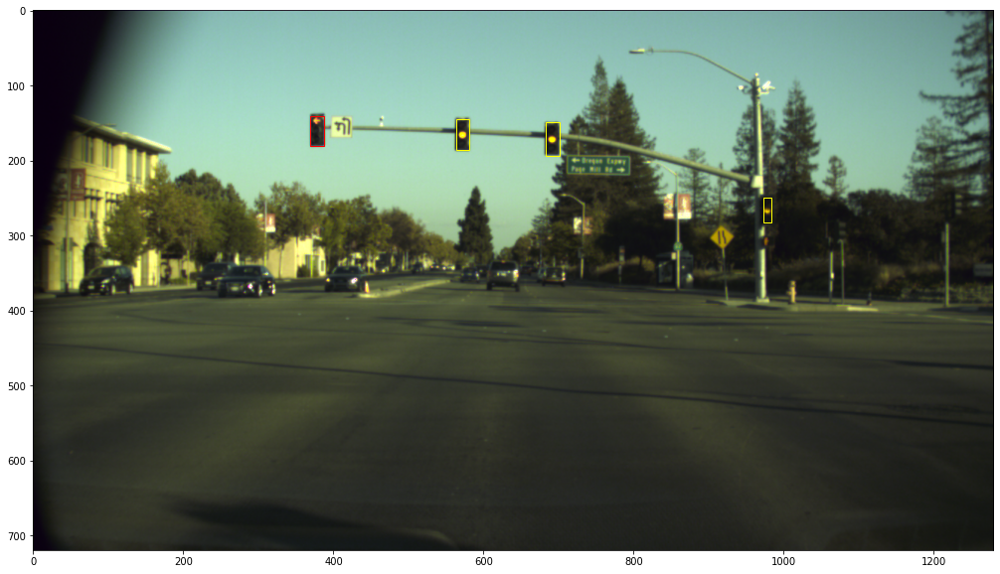

#########################################TFrecord Information#########################################
Name of the TFrecord: b'/workspace/label_files/rgb/train/2015-10-05-11-26-32_bag/96592.png'
The shape of the image is: (720, 1280, 3)
The are 5 boxes in the image:
The are 5 objects in the image:
[2 2 2 2 2]
[2 2 2 2 2]
[2 2 2 2 2]
[2 2 2 2 2]
[2 2 2 2 2]


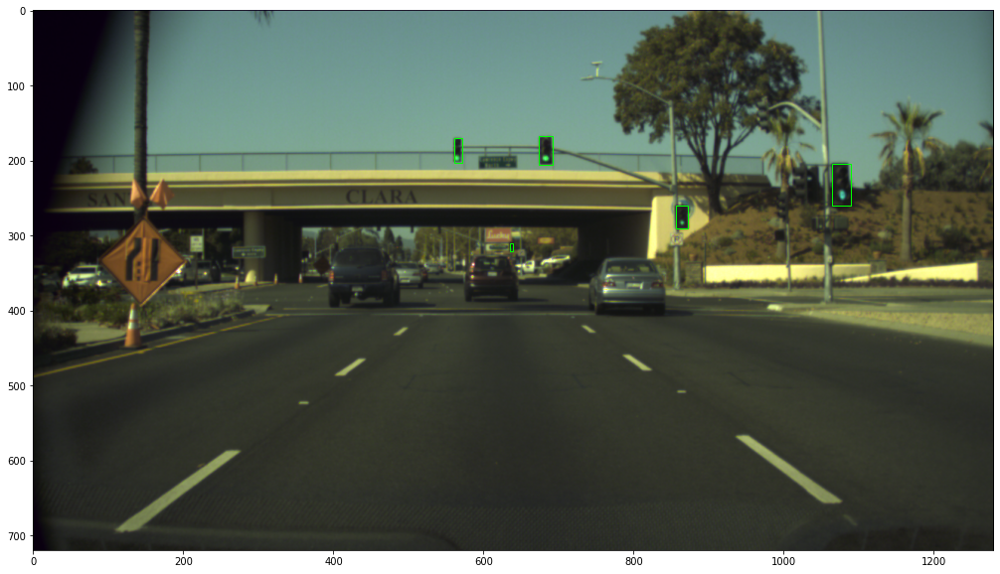

#########################################TFrecord Information#########################################
Name of the TFrecord: b'/workspace/label_files/rgb/train/2015-10-05-16-02-30_bag/612760.png'
The shape of the image is: (720, 1280, 3)
The are 3 boxes in the image:
The are 3 objects in the image:
[2 2 2]
[2 2 2]
[2 2 2]


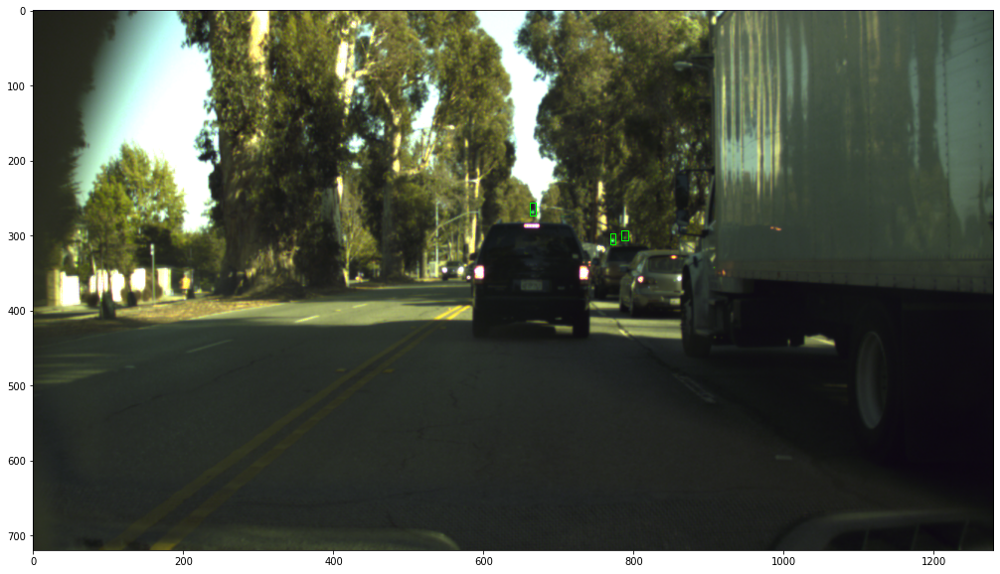

#########################################TFrecord Information#########################################
Name of the TFrecord: b'/workspace/label_files/rgb/train/2015-10-05-14-40-46_bag/506692.png'
The shape of the image is: (720, 1280, 3)
The are 1 boxes in the image:
The are 1 objects in the image:
[4]


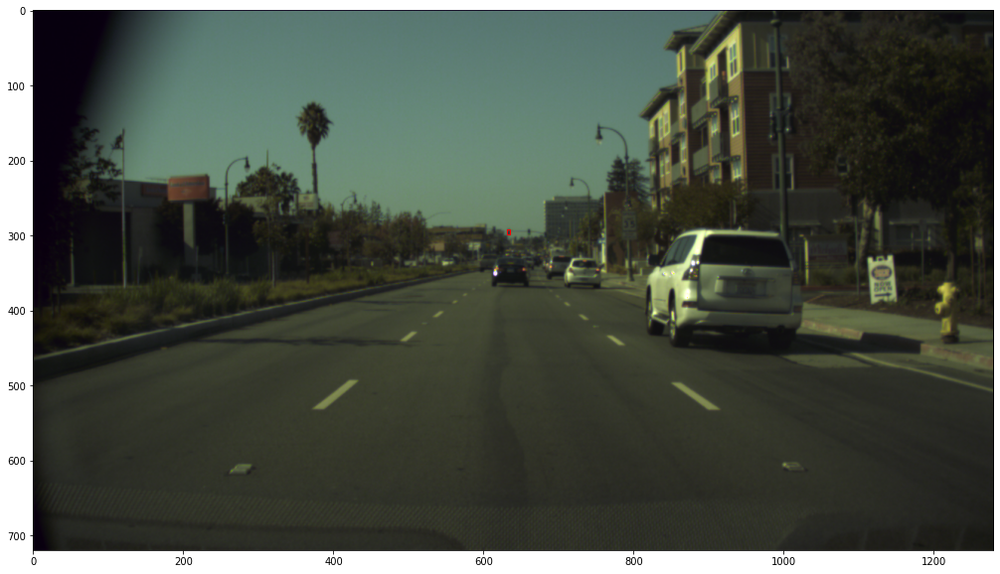

#########################################TFrecord Information#########################################
Name of the TFrecord: b'/workspace/label_files/rgb/train/2015-10-05-14-40-46_bag/570516.png'
The shape of the image is: (720, 1280, 3)
The are 2 boxes in the image:
The are 2 objects in the image:
[4 4]
[4 4]


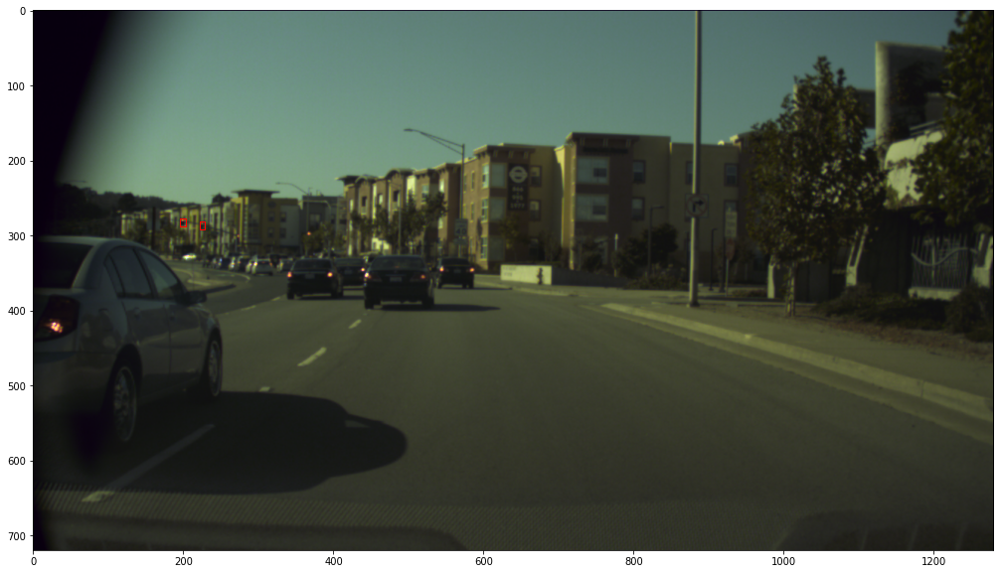

#########################################TFrecord Information#########################################
Name of the TFrecord: b'/workspace/label_files/rgb/train/2015-10-05-14-40-46_bag/552088.png'
The shape of the image is: (720, 1280, 3)
The are 4 boxes in the image:
The are 4 objects in the image:
[3 2 4 3]
[3 2 4 3]
[3 2 4 3]
[3 2 4 3]


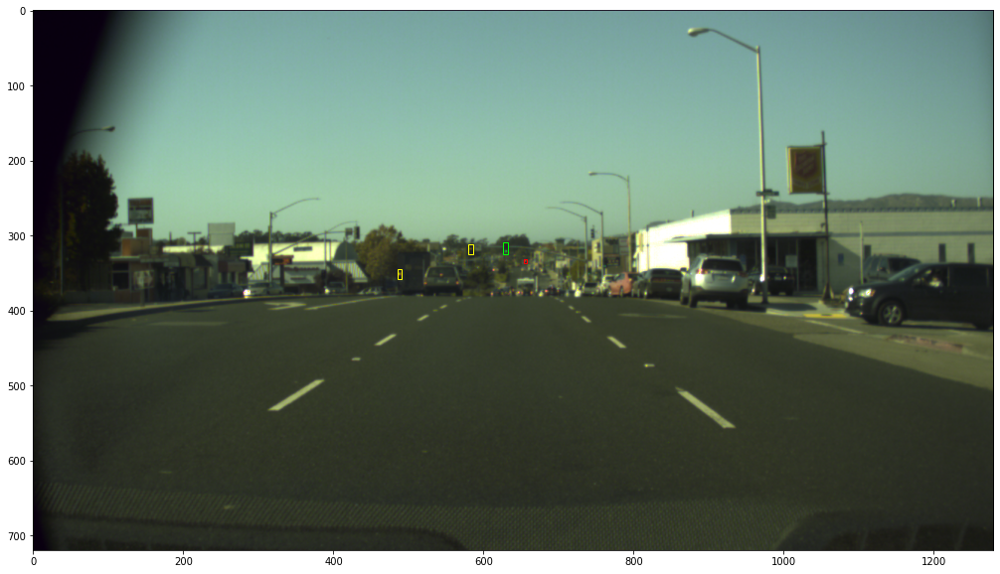

#########################################TFrecord Information#########################################
Name of the TFrecord: b'/workspace/label_files/rgb/train/2015-10-05-14-40-46_bag/559430.png'
The shape of the image is: (720, 1280, 3)
The are 4 boxes in the image:
The are 4 objects in the image:
[4 2 4 2]
[4 2 4 2]
[4 2 4 2]
[4 2 4 2]


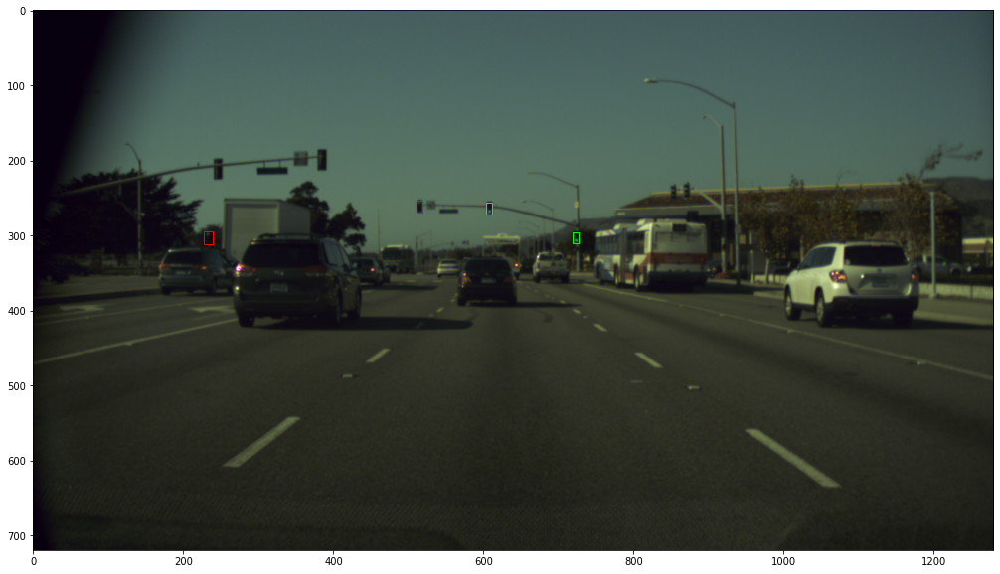

#########################################TFrecord Information#########################################
Name of the TFrecord: b'/workspace/label_files/rgb/train/2015-10-05-14-40-46_bag/559498.png'
The shape of the image is: (720, 1280, 3)
The are 4 boxes in the image:
The are 4 objects in the image:
[2 1 2 2]
[2 1 2 2]
[2 1 2 2]
[2 1 2 2]


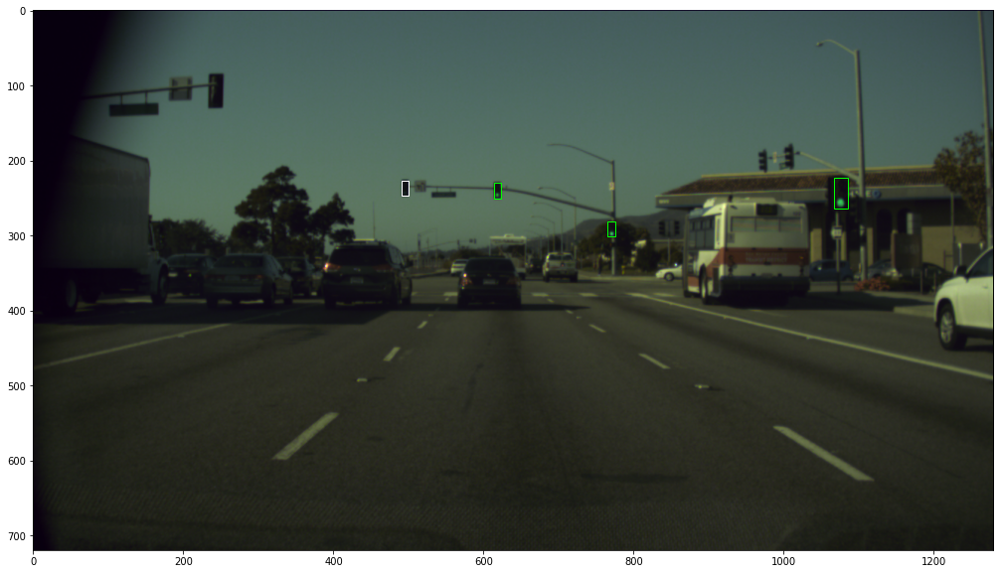

#########################################TFrecord Information#########################################
Name of the TFrecord: b'/workspace/label_files/rgb/train/2015-10-05-14-40-46_bag/526536.png'
The shape of the image is: (720, 1280, 3)
The are 3 boxes in the image:
The are 3 objects in the image:
[2 2 2]
[2 2 2]
[2 2 2]


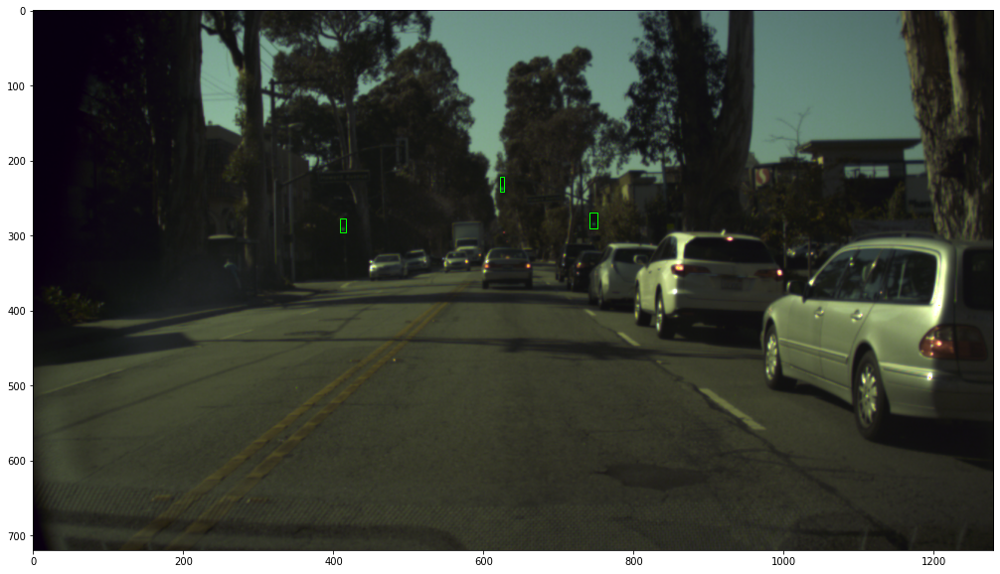

#########################################TFrecord Information#########################################
Name of the TFrecord: b'/workspace/label_files/rgb/train/2015-10-05-16-02-30_bag/629502.png'
The shape of the image is: (720, 1280, 3)
The are 3 boxes in the image:
The are 3 objects in the image:
[2 4 2]
[2 4 2]
[2 4 2]


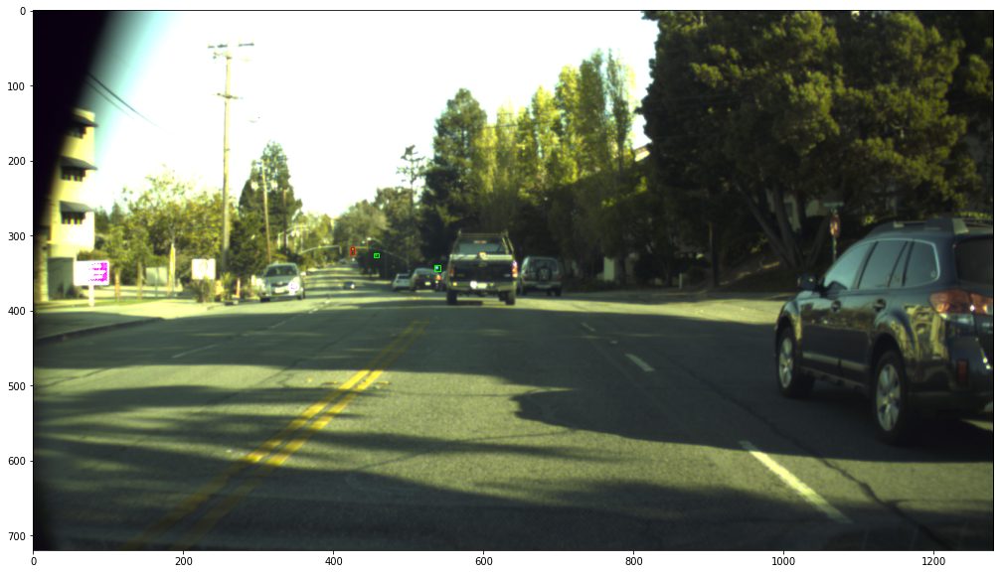

#########################################TFrecord Information#########################################
Name of the TFrecord: b'/workspace/label_files/rgb/train/2015-10-05-16-02-30_bag/660636.png'
The shape of the image is: (720, 1280, 3)
The are 3 boxes in the image:
The are 3 objects in the image:
[1 2 2]
[1 2 2]
[1 2 2]


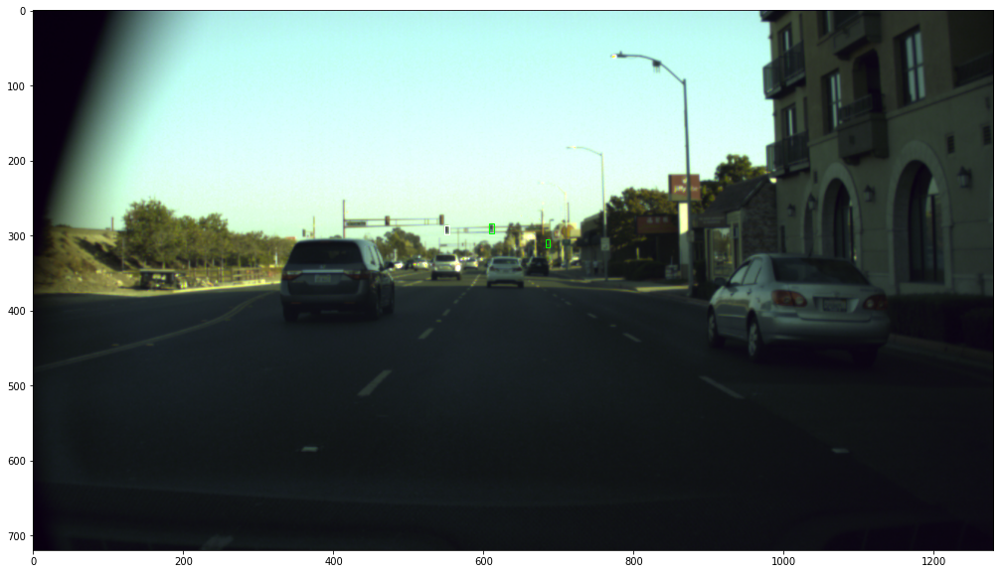

#########################################TFrecord Information#########################################
Name of the TFrecord: b'/workspace/label_files/rgb/train/2015-10-05-10-55-33_bag/68562.png'
The shape of the image is: (720, 1280, 3)
The are 3 boxes in the image:
The are 3 objects in the image:
[2 2 4]
[2 2 4]
[2 2 4]


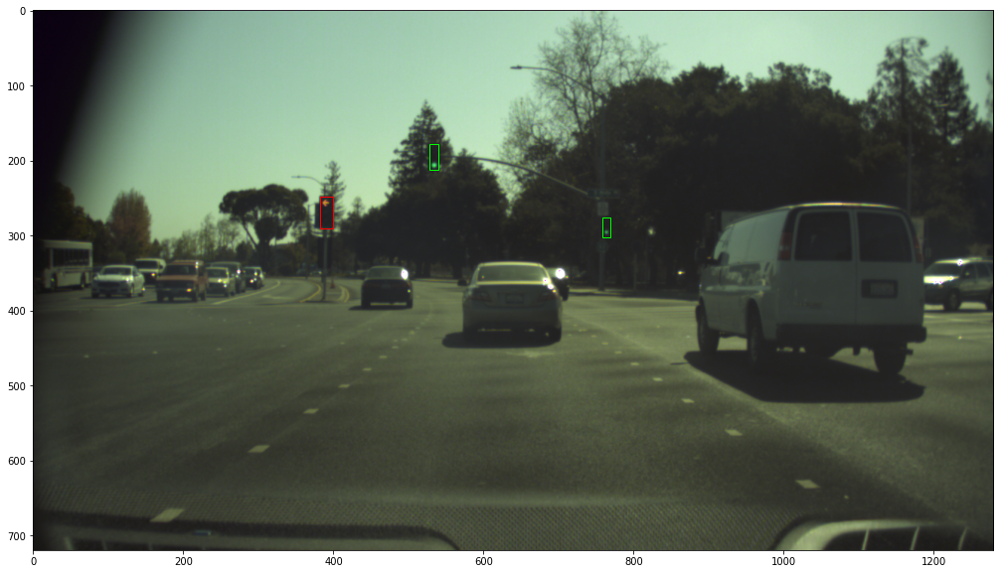

#########################################TFrecord Information#########################################
Name of the TFrecord: b'/workspace/label_files/rgb/train/2015-10-05-16-02-30_bag/610120.png'
The shape of the image is: (720, 1280, 3)
The are 3 boxes in the image:
The are 3 objects in the image:
[4 4 4]
[4 4 4]
[4 4 4]


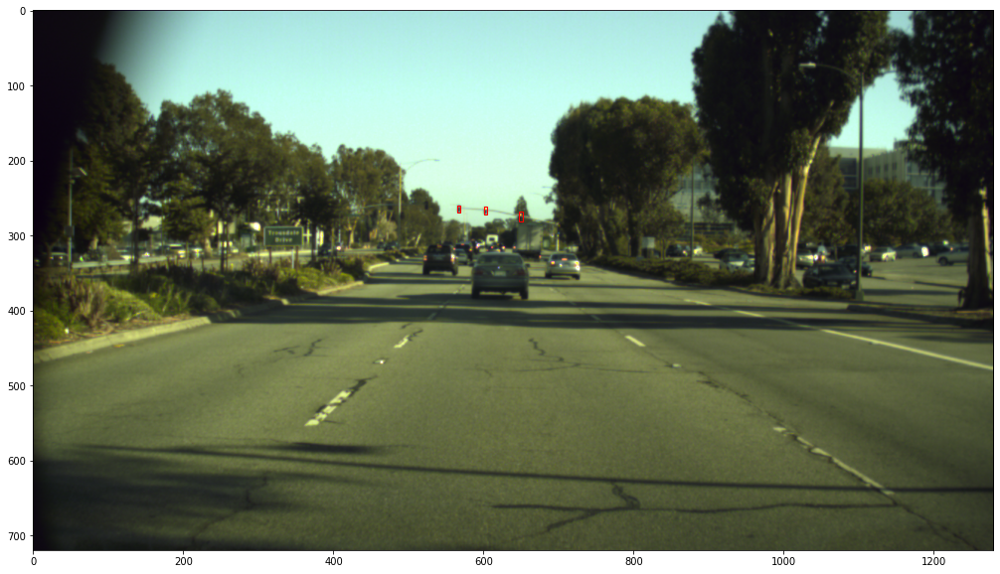

#########################################TFrecord Information#########################################
Name of the TFrecord: b'/workspace/label_files/rgb/train/2015-10-05-11-26-32_bag/96940.png'
The shape of the image is: (720, 1280, 3)
The are 6 boxes in the image:
The are 6 objects in the image:
[2 2 2 3 3 4]
[2 2 2 3 3 4]
[2 2 2 3 3 4]
[2 2 2 3 3 4]
[2 2 2 3 3 4]
[2 2 2 3 3 4]


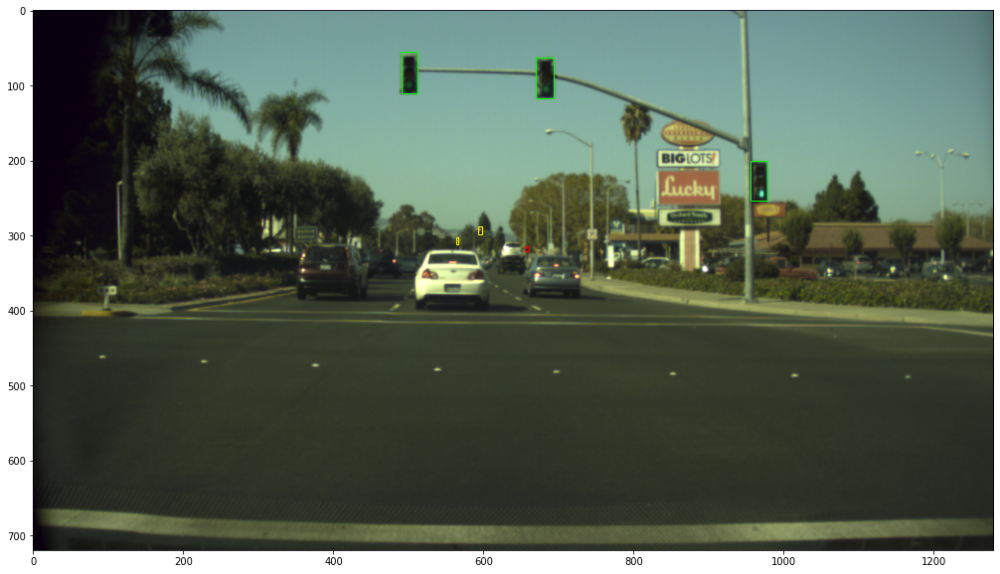

#########################################TFrecord Information#########################################
Name of the TFrecord: b'/workspace/label_files/rgb/train/2015-10-05-16-02-30_bag/666718.png'
The shape of the image is: (720, 1280, 3)
The are 4 boxes in the image:
The are 4 objects in the image:
[2 2 2 4]
[2 2 2 4]
[2 2 2 4]
[2 2 2 4]


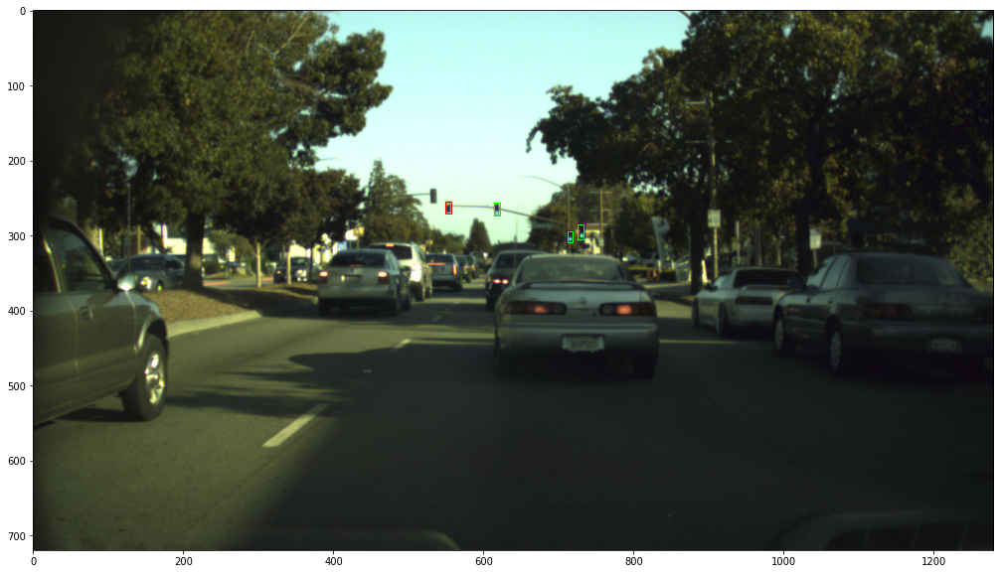

In [51]:
for batches in train_tfrecord.take(15):
    display_instances(batches)

## Validation TFrecord

In [25]:
valid_tfrecord = get_dataset("./tfrecords/valid/valid.tfrecords")

INFO:tensorflow:Reading unweighted datasets: ['./tfrecords/valid/valid.tfrecords']
INFO:tensorflow:Reading record datasets for input file: ['./tfrecords/valid/valid.tfrecords']
INFO:tensorflow:Number of filenames to read: 1


#########################################TFrecord Information#########################################
Name of the TFrecord: b'/workspace/label_files/rgb/train/2015-05-29-15-29-39_arastradero_traffic_light_loop_bag/13676.png'
The shape of the image is: (720, 1280, 3)
The are 5 boxes in the image:
The are 5 objects in the image:
[4 4 4 4 4]
[4 4 4 4 4]
[4 4 4 4 4]
[4 4 4 4 4]
[4 4 4 4 4]


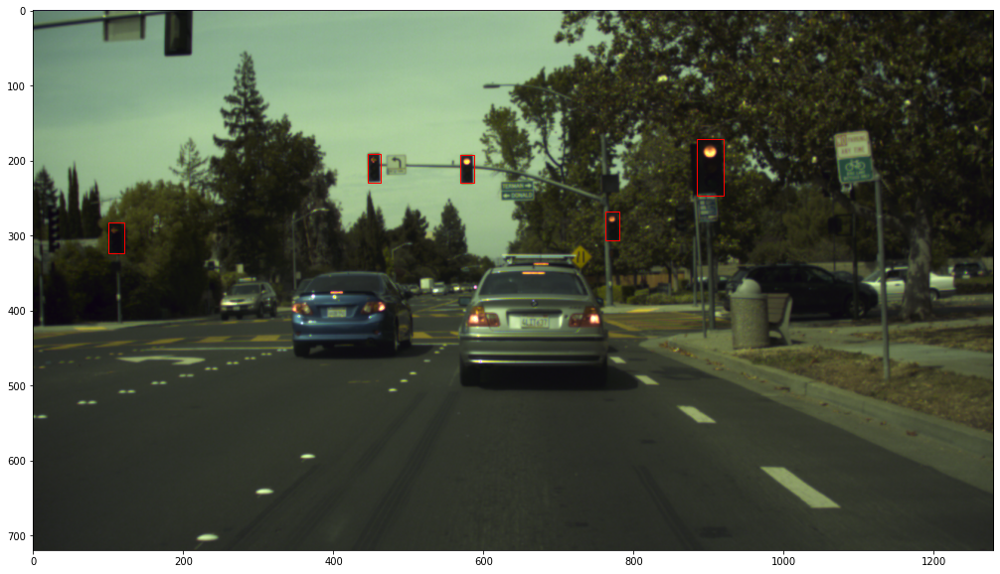

#########################################TFrecord Information#########################################
Name of the TFrecord: b'/workspace/label_files/rgb/train/2017-02-03-11-44-56_los_altos_mountain_view_traffic_lights_bag/216828.png'
The shape of the image is: (720, 1280, 3)
The are 4 boxes in the image:
The are 4 objects in the image:
[4 2 2 4]
[4 2 2 4]
[4 2 2 4]
[4 2 2 4]


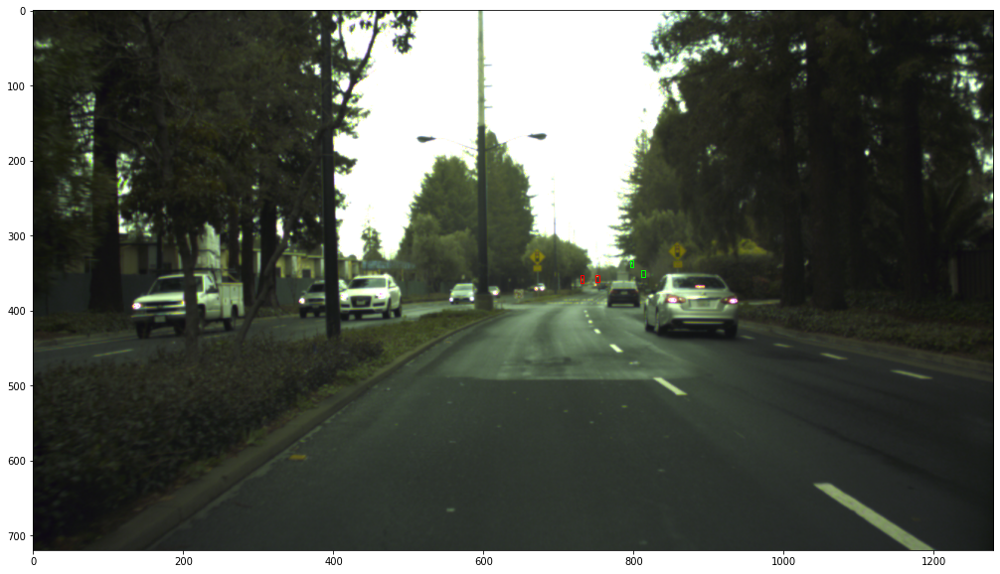

#########################################TFrecord Information#########################################
Name of the TFrecord: b'/workspace/label_files/rgb/train/2015-05-29-15-29-39_arastradero_traffic_light_loop_bag/29848.png'
The shape of the image is: (720, 1280, 3)
The are 5 boxes in the image:
The are 5 objects in the image:
[4 1 4 4 4]
[4 1 4 4 4]
[4 1 4 4 4]
[4 1 4 4 4]
[4 1 4 4 4]


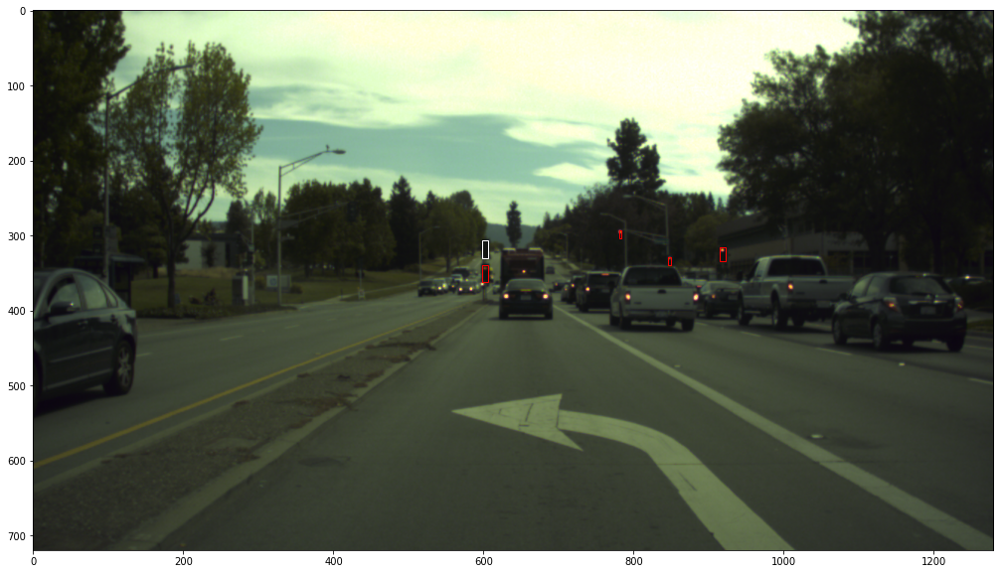

#########################################TFrecord Information#########################################
Name of the TFrecord: b'/workspace/label_files/rgb/train/2017-02-03-11-44-56_los_altos_mountain_view_traffic_lights_bag/234526.png'
The shape of the image is: (720, 1280, 3)
The are 3 boxes in the image:
The are 3 objects in the image:
[2 2 2]
[2 2 2]
[2 2 2]


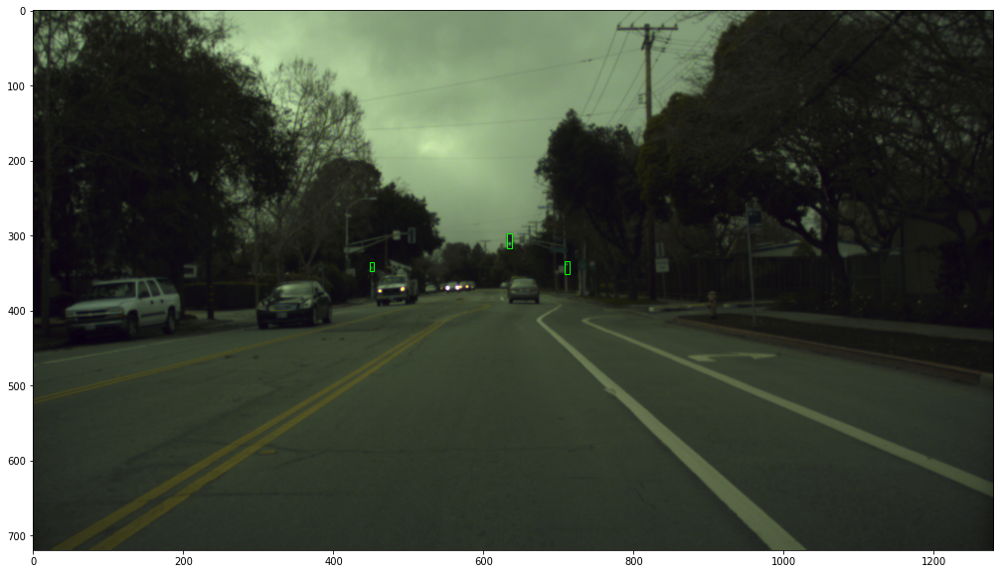

#########################################TFrecord Information#########################################
Name of the TFrecord: b'/workspace/label_files/rgb/train/2015-05-29-15-29-39_arastradero_traffic_light_loop_bag/27762.png'
The shape of the image is: (720, 1280, 3)
The are 2 boxes in the image:
The are 2 objects in the image:
[2 4]
[2 4]


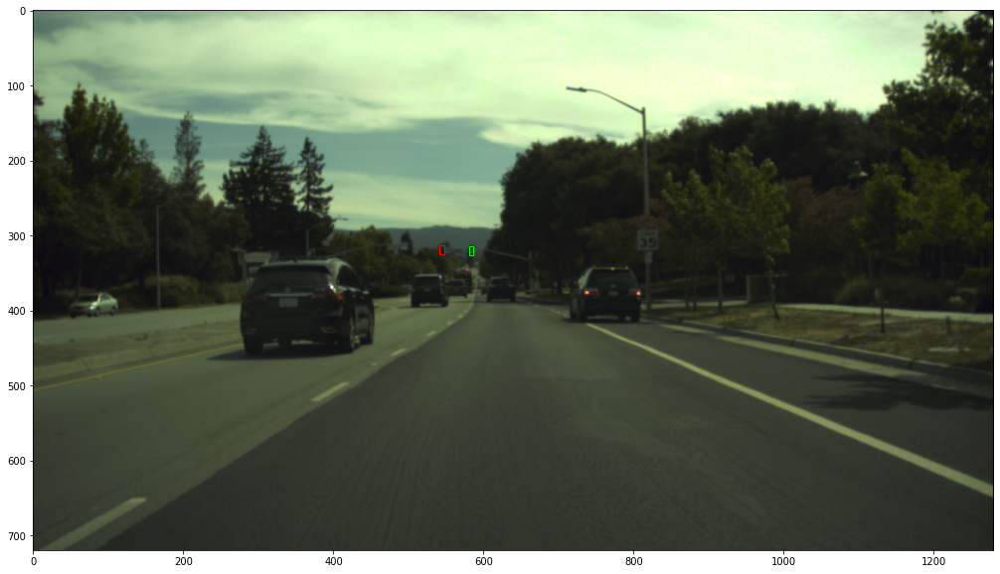

#########################################TFrecord Information#########################################
Name of the TFrecord: b'/workspace/label_files/rgb/train/2017-02-03-11-44-56_los_altos_mountain_view_traffic_lights_bag/228802.png'
The shape of the image is: (720, 1280, 3)
The are 4 boxes in the image:
The are 4 objects in the image:
[4 4 2 2]
[4 4 2 2]
[4 4 2 2]
[4 4 2 2]


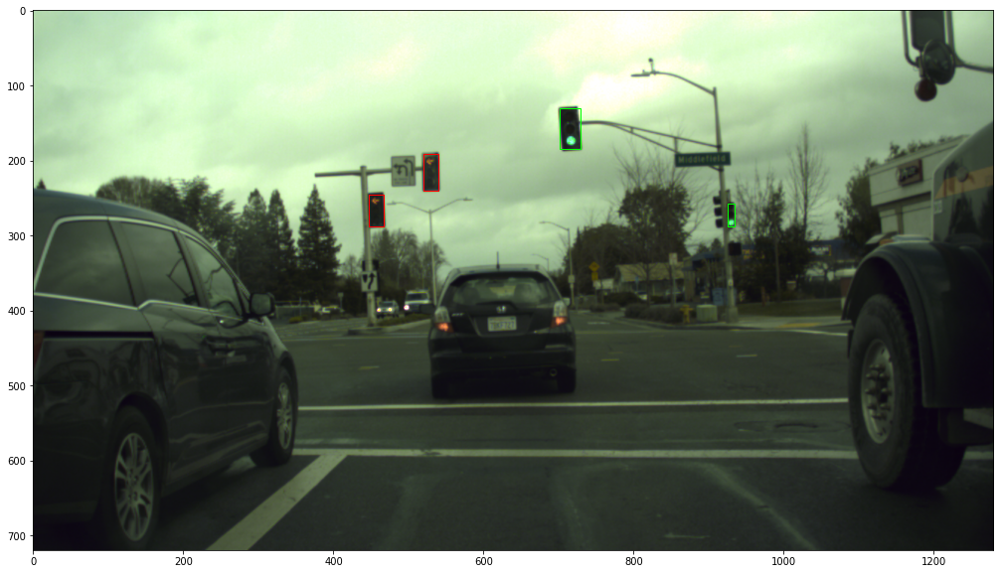

#########################################TFrecord Information#########################################
Name of the TFrecord: b'/workspace/label_files/rgb/train/2017-02-03-11-44-56_los_altos_mountain_view_traffic_lights_bag/234298.png'
The shape of the image is: (720, 1280, 3)
The are 2 boxes in the image:
The are 2 objects in the image:
[2 2]
[2 2]


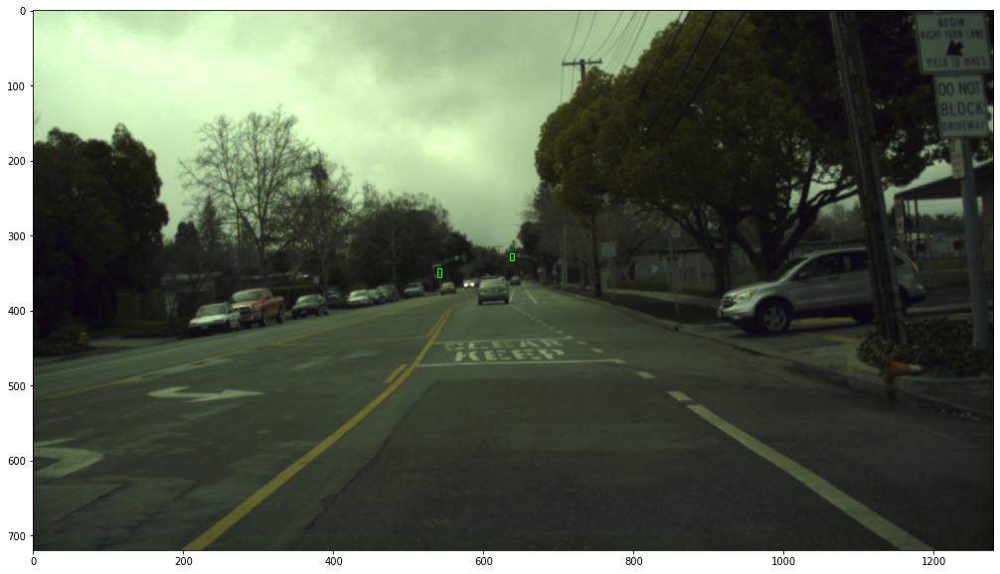

#########################################TFrecord Information#########################################
Name of the TFrecord: b'/workspace/label_files/rgb/train/2015-05-29-15-29-39_arastradero_traffic_light_loop_bag/10786.png'
The shape of the image is: (720, 1280, 3)
The are 1 boxes in the image:
The are 1 objects in the image:
[2]


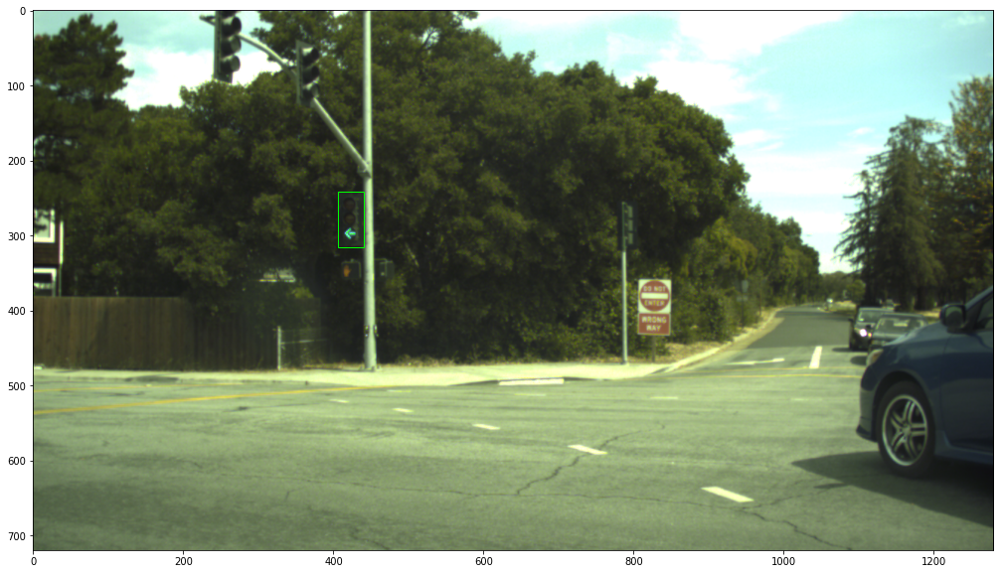

#########################################TFrecord Information#########################################
Name of the TFrecord: b'/workspace/label_files/rgb/train/2015-05-29-15-29-39_arastradero_traffic_light_loop_bag/21730.png'
The shape of the image is: (720, 1280, 3)
The are 4 boxes in the image:
The are 4 objects in the image:
[4 4 4 4]
[4 4 4 4]
[4 4 4 4]
[4 4 4 4]


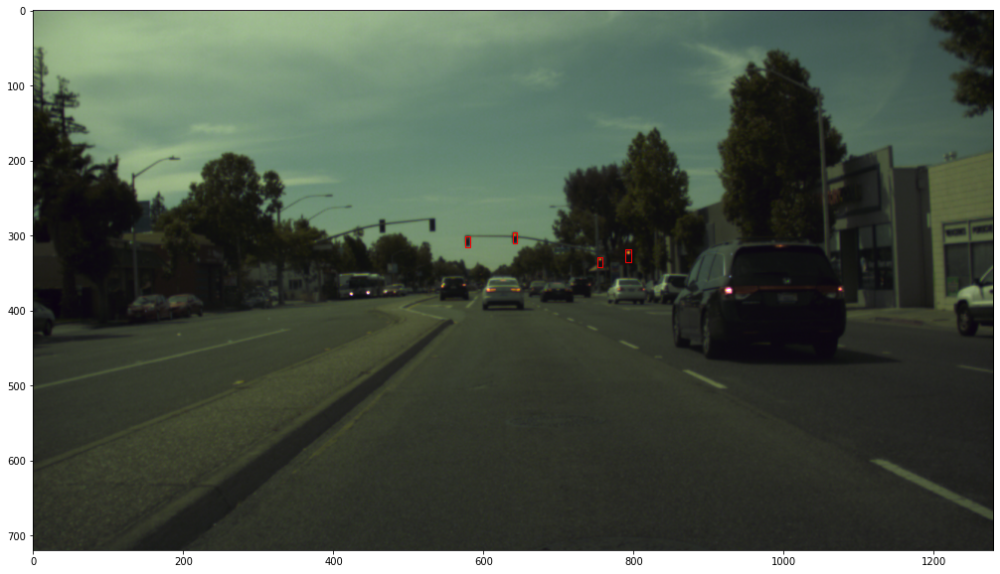

#########################################TFrecord Information#########################################
Name of the TFrecord: b'/workspace/label_files/rgb/train/2017-02-03-11-44-56_los_altos_mountain_view_traffic_lights_bag/216896.png'
The shape of the image is: (720, 1280, 3)
The are 5 boxes in the image:
The are 5 objects in the image:
[4 2 2 2 4]
[4 2 2 2 4]
[4 2 2 2 4]
[4 2 2 2 4]
[4 2 2 2 4]


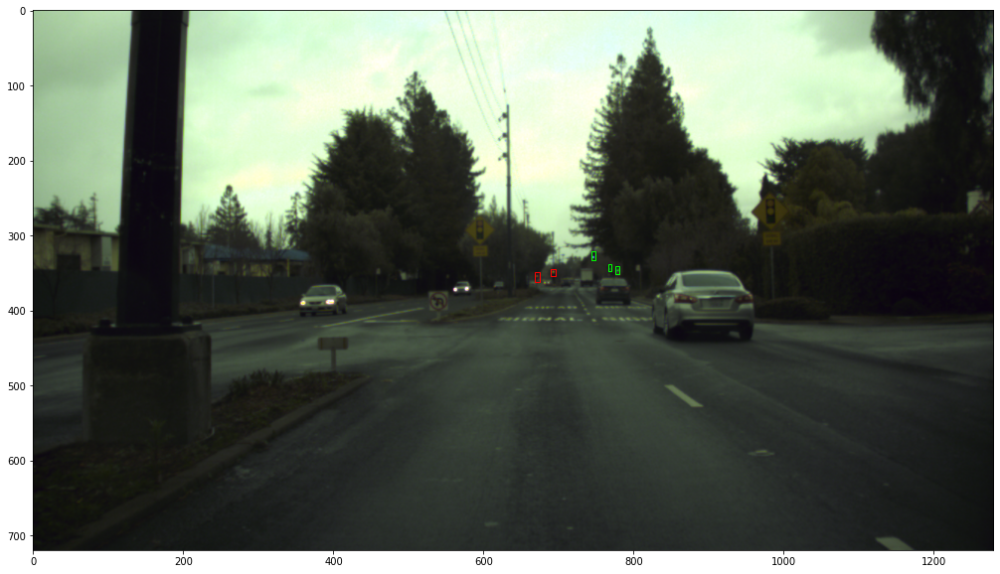

#########################################TFrecord Information#########################################
Name of the TFrecord: b'/workspace/label_files/rgb/train/2015-10-05-10-52-01_bag/27582.png'
The shape of the image is: (720, 1280, 3)
The are 3 boxes in the image:
The are 3 objects in the image:
[2 2 2]
[2 2 2]
[2 2 2]


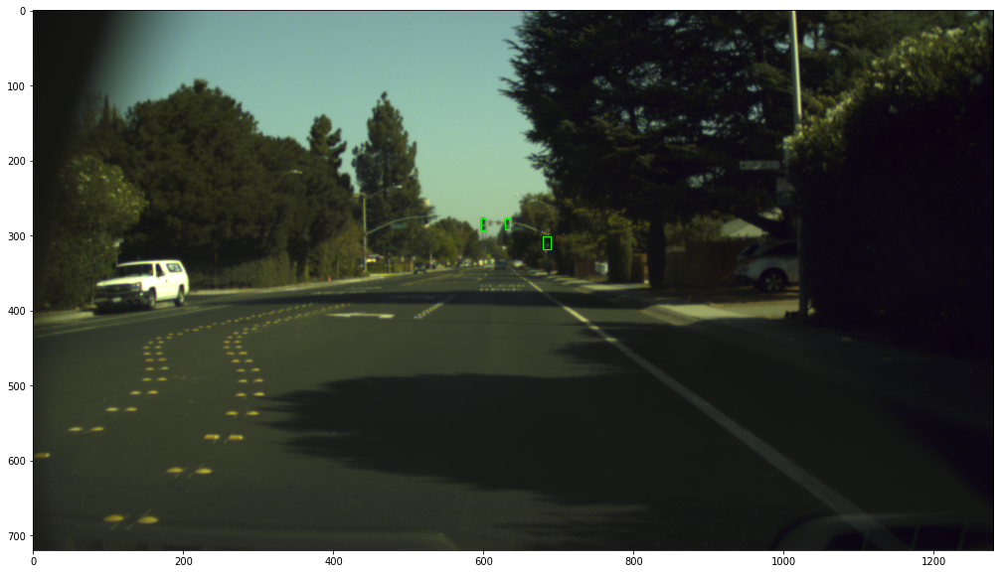

#########################################TFrecord Information#########################################
Name of the TFrecord: b'/workspace/label_files/rgb/train/2015-05-29-15-29-39_arastradero_traffic_light_loop_bag/15096.png'
The shape of the image is: (720, 1280, 3)
The are 5 boxes in the image:
The are 5 objects in the image:
[2 2 2 2 2]
[2 2 2 2 2]
[2 2 2 2 2]
[2 2 2 2 2]
[2 2 2 2 2]


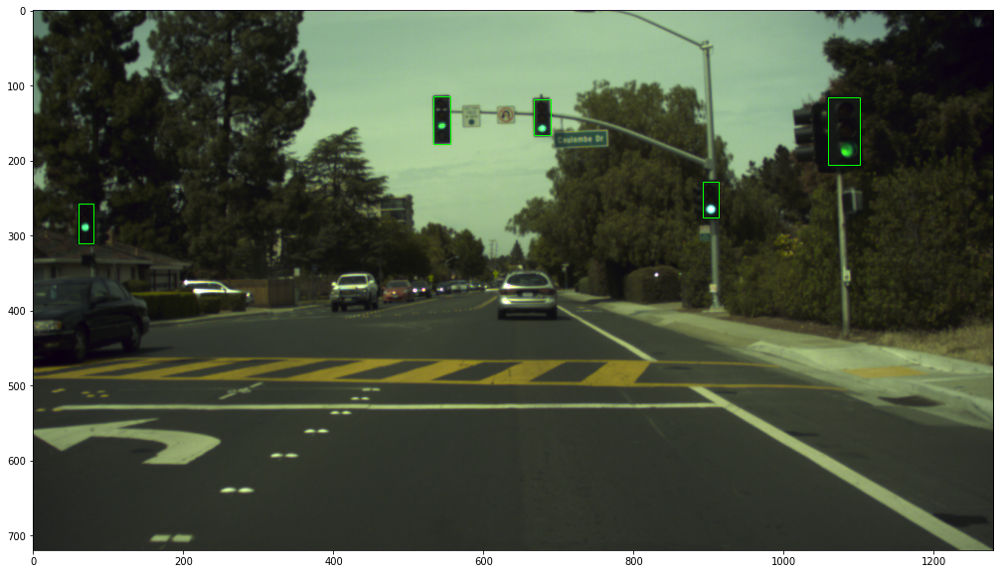

#########################################TFrecord Information#########################################
Name of the TFrecord: b'/workspace/label_files/rgb/train/2017-02-03-11-44-56_los_altos_mountain_view_traffic_lights_bag/223212.png'
The shape of the image is: (720, 1280, 3)
The are 4 boxes in the image:
The are 4 objects in the image:
[2 4 4 4]
[2 4 4 4]
[2 4 4 4]
[2 4 4 4]


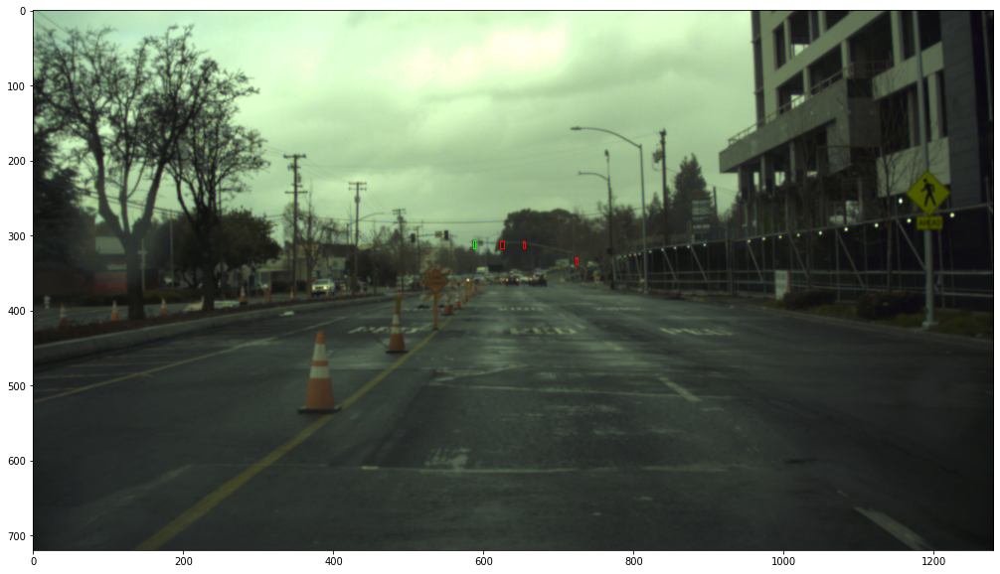

#########################################TFrecord Information#########################################
Name of the TFrecord: b'/workspace/label_files/rgb/train/2015-05-29-15-29-39_arastradero_traffic_light_loop_bag/10926.png'
The shape of the image is: (720, 1280, 3)
The are 2 boxes in the image:
The are 2 objects in the image:
[2 2]
[2 2]


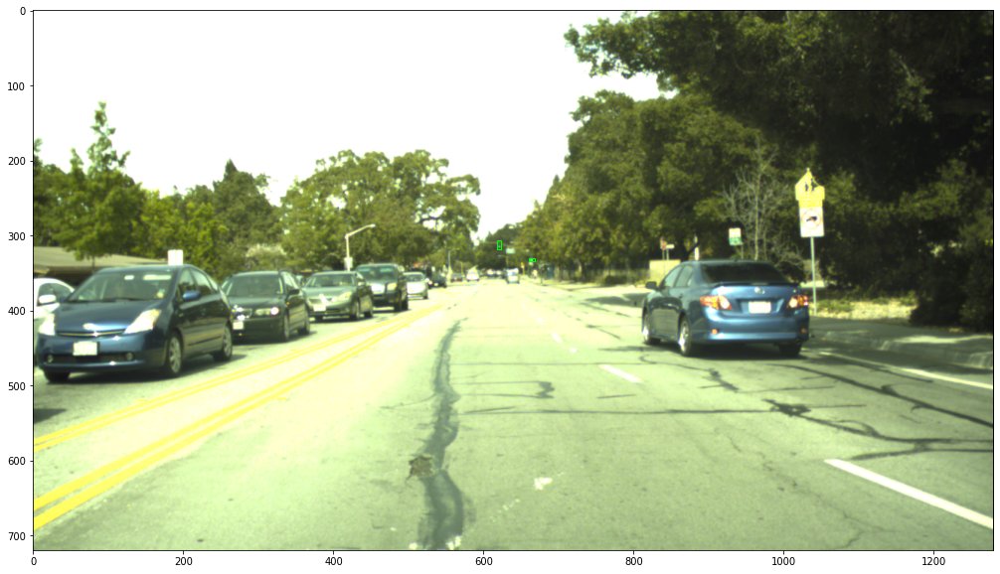

#########################################TFrecord Information#########################################
Name of the TFrecord: b'/workspace/label_files/rgb/train/2017-02-03-11-44-56_los_altos_mountain_view_traffic_lights_bag/237900.png'
The shape of the image is: (720, 1280, 3)
The are 3 boxes in the image:
The are 3 objects in the image:
[2 2 2]
[2 2 2]
[2 2 2]


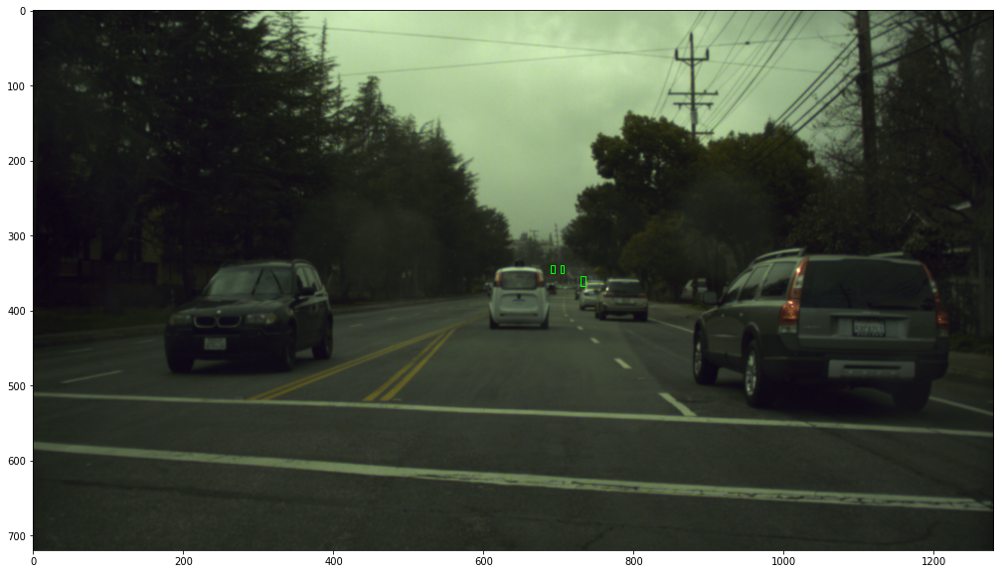

In [52]:
for batches in valid_tfrecord.take(15):
    display_instances(batches)

## Test TFrecord

In [28]:
test_tfrecord = get_dataset("./tfrecords/test/test.tfrecords")

INFO:tensorflow:Reading unweighted datasets: ['./tfrecords/test/test.tfrecords']
INFO:tensorflow:Reading record datasets for input file: ['./tfrecords/test/test.tfrecords']
INFO:tensorflow:Number of filenames to read: 1


#########################################TFrecord Information#########################################
Name of the TFrecord: b'/workspace/label_files/rgb/test/34656.png'
The shape of the image is: (720, 1280, 3)
The are 2 boxes in the image:
The are 2 objects in the image:
[4 4]
[4 4]


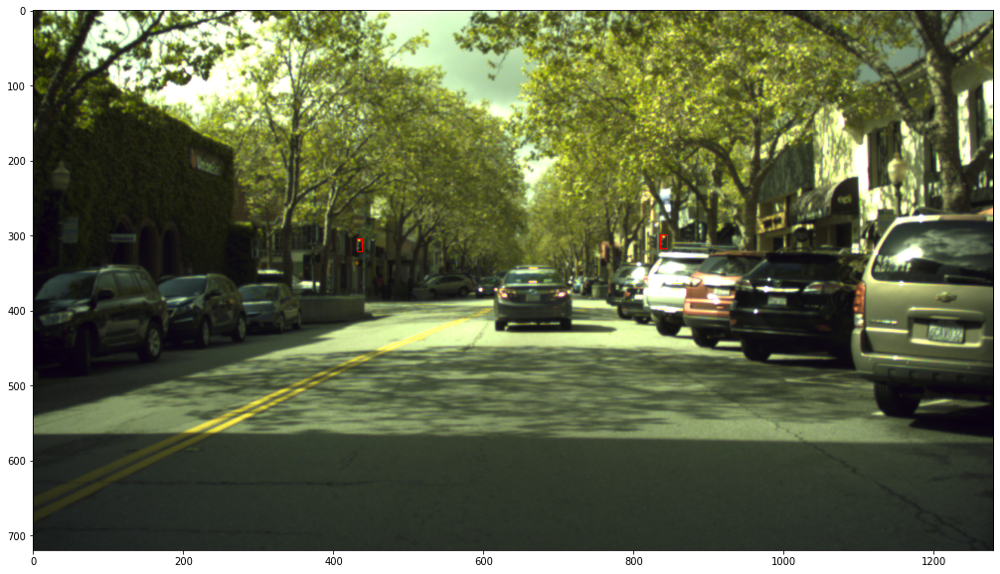

#########################################TFrecord Information#########################################
Name of the TFrecord: b'/workspace/label_files/rgb/test/30174.png'
The shape of the image is: (720, 1280, 3)
The are 1 boxes in the image:
The are 1 objects in the image:
[2]


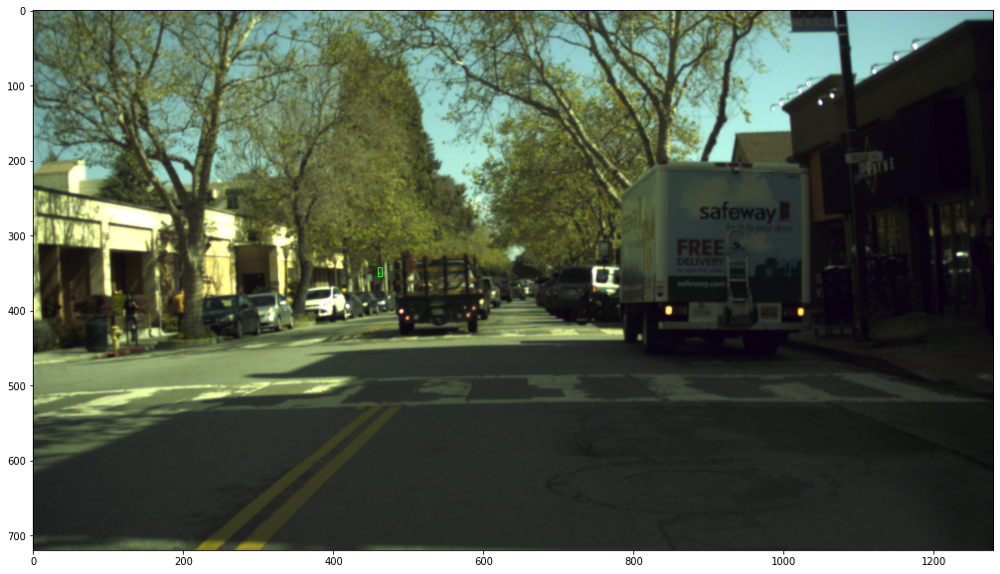

#########################################TFrecord Information#########################################
Name of the TFrecord: b'/workspace/label_files/rgb/test/29606.png'
The shape of the image is: (720, 1280, 3)
The are 2 boxes in the image:
The are 2 objects in the image:
[2 2]
[2 2]


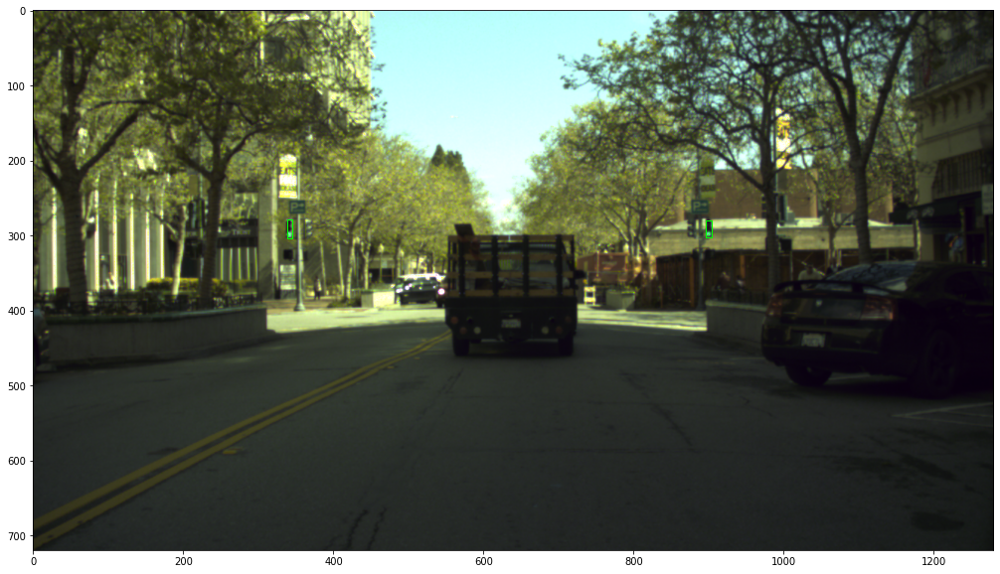

#########################################TFrecord Information#########################################
Name of the TFrecord: b'/workspace/label_files/rgb/test/36450.png'
The shape of the image is: (720, 1280, 3)
The are 1 boxes in the image:
The are 1 objects in the image:
[2]


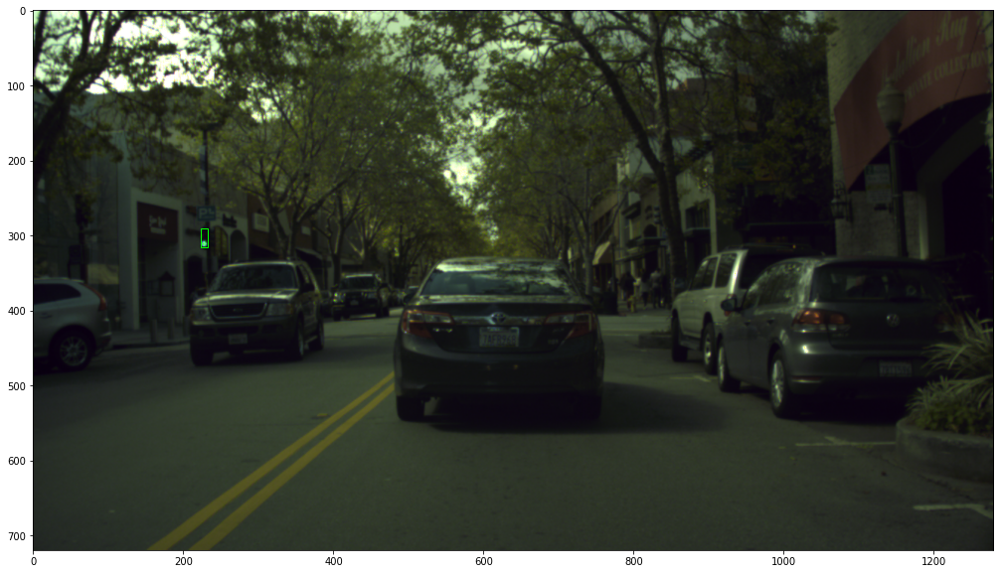

#########################################TFrecord Information#########################################
Name of the TFrecord: b'/workspace/label_files/rgb/test/37884.png'
The shape of the image is: (720, 1280, 3)
The are 2 boxes in the image:
The are 2 objects in the image:
[2 2]
[2 2]


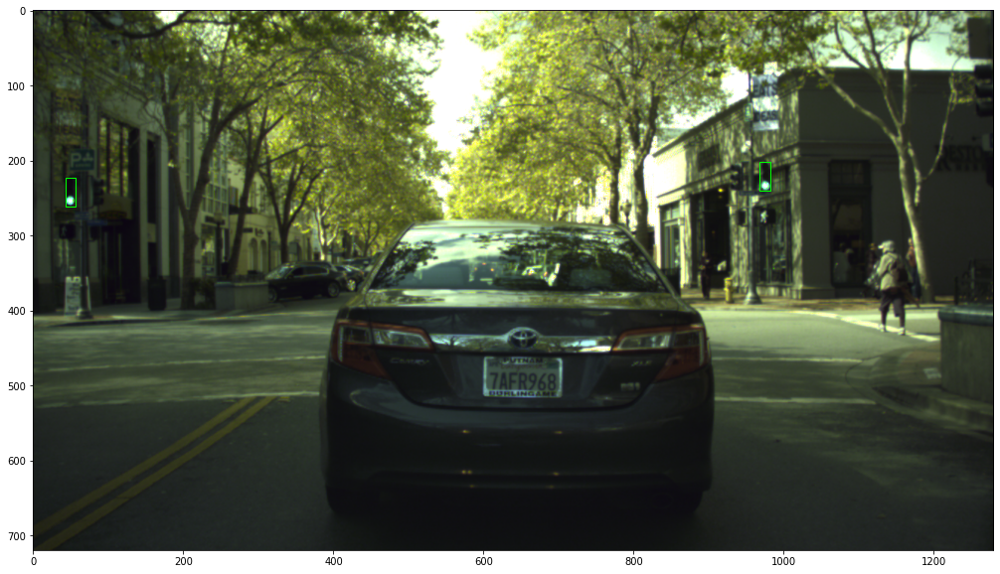

#########################################TFrecord Information#########################################
Name of the TFrecord: b'/workspace/label_files/rgb/test/38186.png'
The shape of the image is: (720, 1280, 3)
The are 1 boxes in the image:
The are 1 objects in the image:
[2]


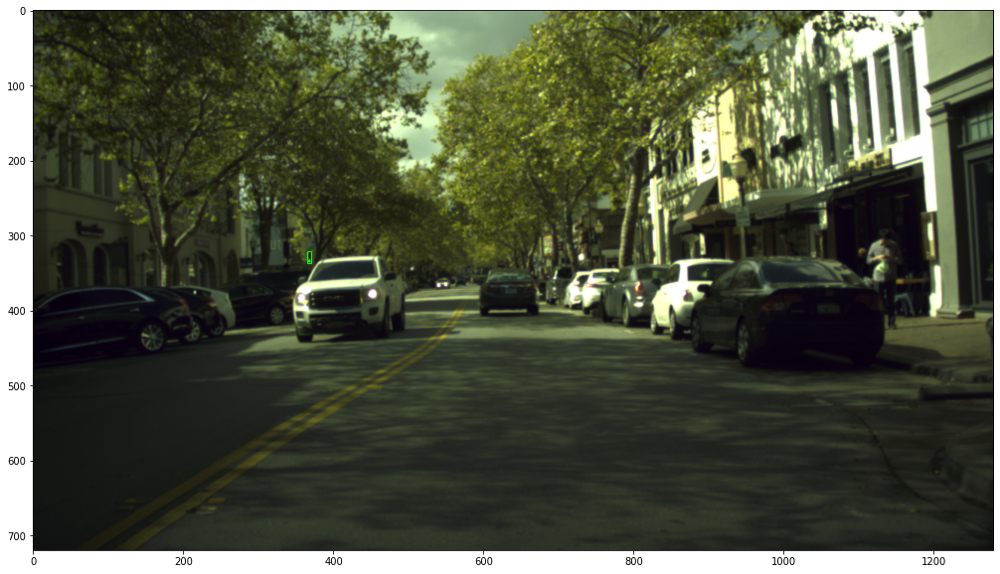

#########################################TFrecord Information#########################################
Name of the TFrecord: b'/workspace/label_files/rgb/test/40332.png'
The shape of the image is: (720, 1280, 3)
The are 2 boxes in the image:
The are 2 objects in the image:
[2 2]
[2 2]


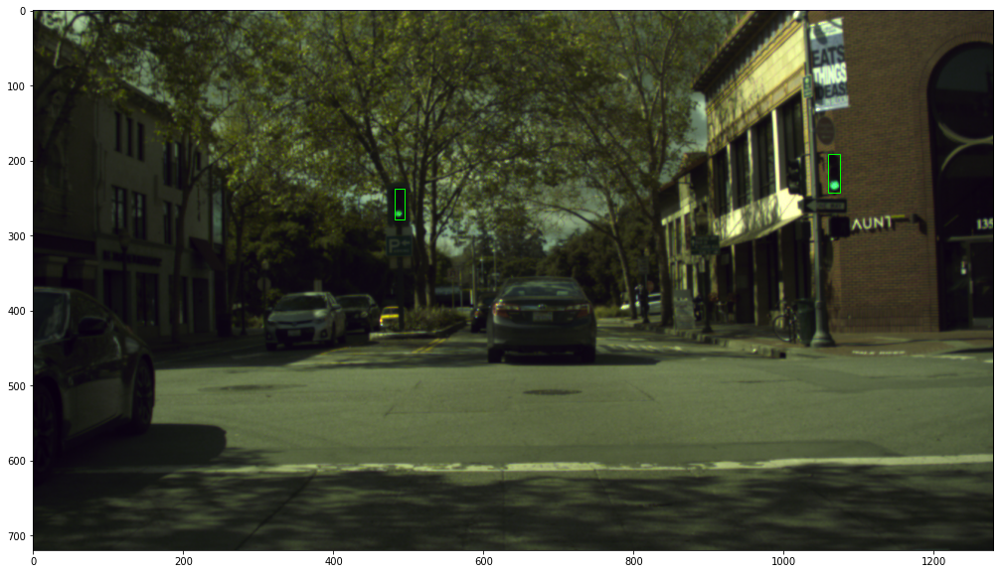

#########################################TFrecord Information#########################################
Name of the TFrecord: b'/workspace/label_files/rgb/test/33400.png'
The shape of the image is: (720, 1280, 3)
The are 2 boxes in the image:
The are 2 objects in the image:
[4 2]
[4 2]


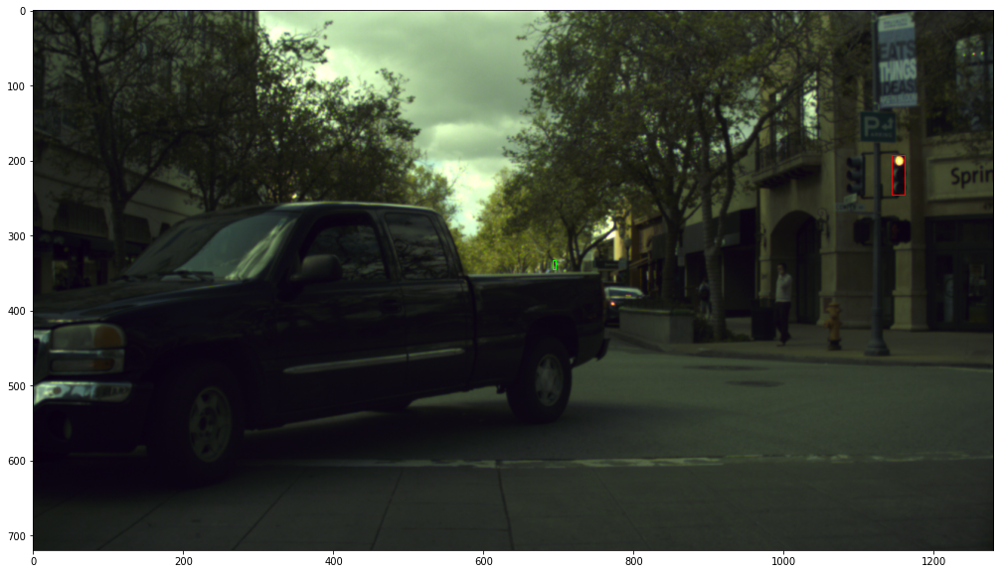

#########################################TFrecord Information#########################################
Name of the TFrecord: b'/workspace/label_files/rgb/test/38192.png'
The shape of the image is: (720, 1280, 3)
The are 1 boxes in the image:
The are 1 objects in the image:
[1]


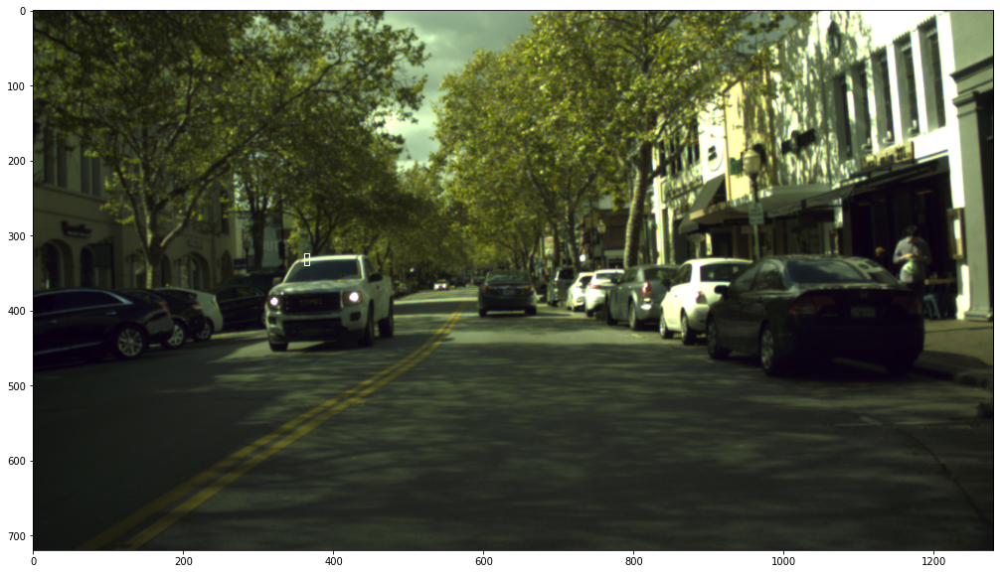

#########################################TFrecord Information#########################################
Name of the TFrecord: b'/workspace/label_files/rgb/test/27556.png'
The shape of the image is: (720, 1280, 3)
The are 3 boxes in the image:
The are 3 objects in the image:
[2 2 4]
[2 2 4]
[2 2 4]


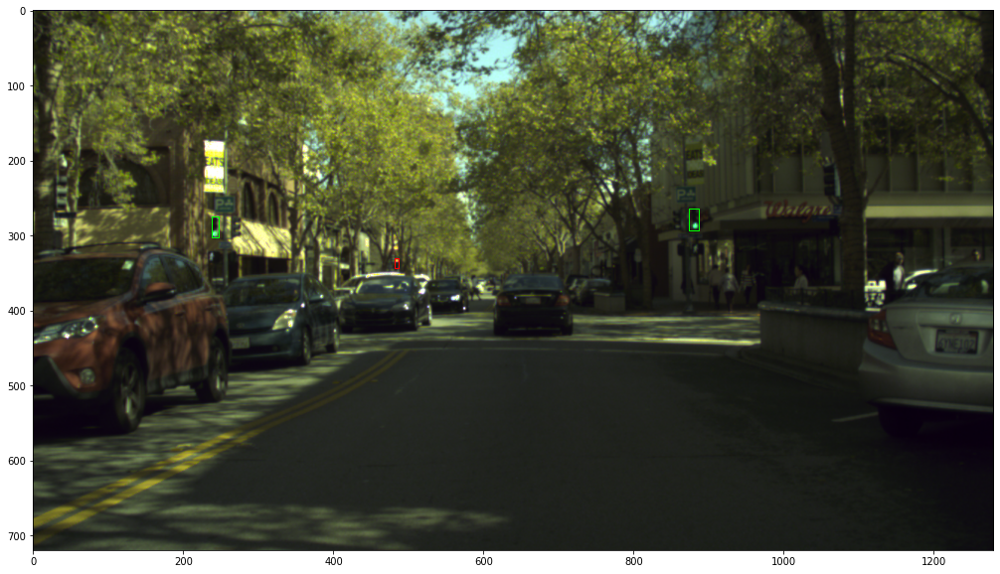

#########################################TFrecord Information#########################################
Name of the TFrecord: b'/workspace/label_files/rgb/test/32890.png'
The shape of the image is: (720, 1280, 3)
The are 3 boxes in the image:
The are 3 objects in the image:
[4 2 2]
[4 2 2]
[4 2 2]


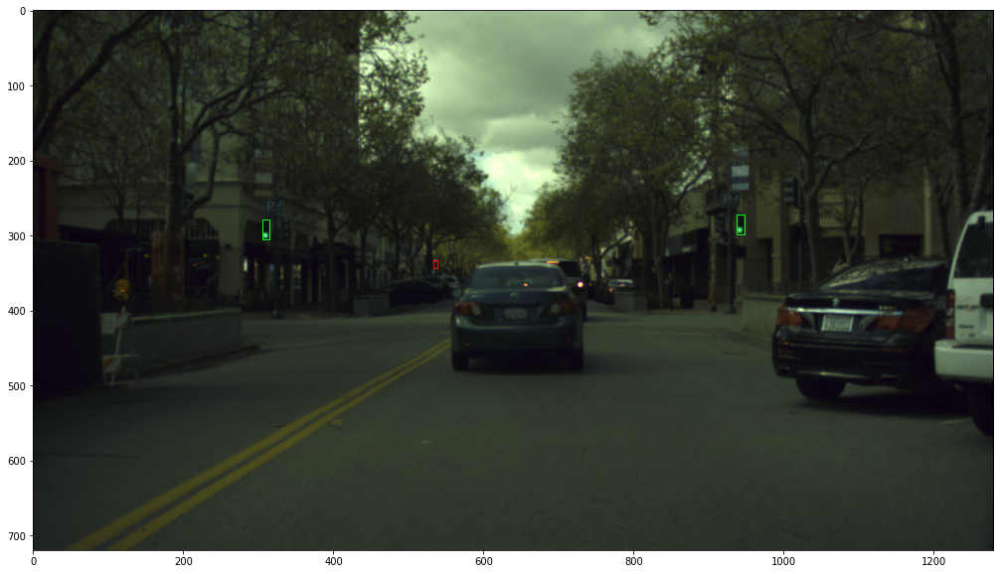

#########################################TFrecord Information#########################################
Name of the TFrecord: b'/workspace/label_files/rgb/test/40410.png'
The shape of the image is: (720, 1280, 3)
The are 1 boxes in the image:
The are 1 objects in the image:
[2]


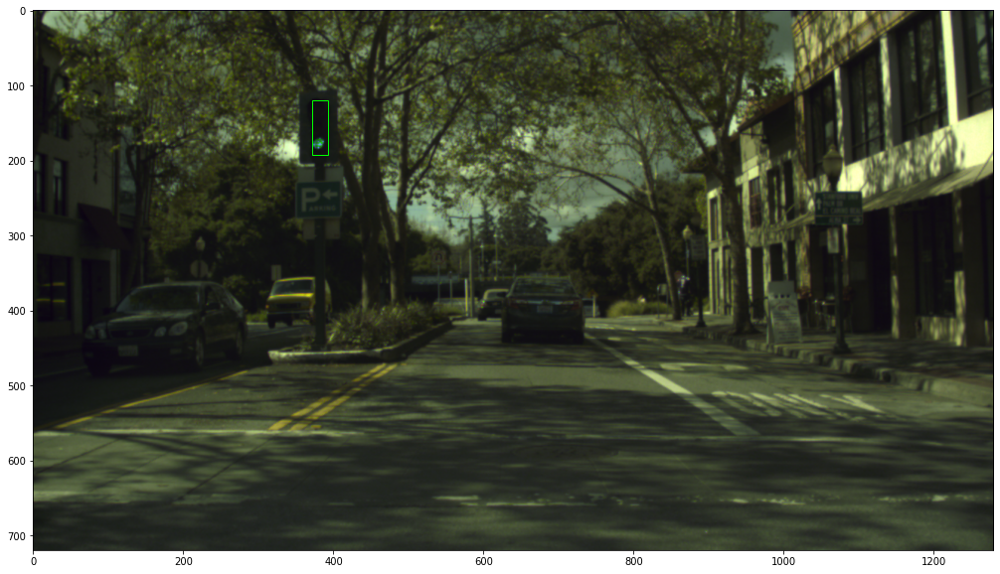

#########################################TFrecord Information#########################################
Name of the TFrecord: b'/workspace/label_files/rgb/test/32684.png'
The shape of the image is: (720, 1280, 3)
The are 2 boxes in the image:
The are 2 objects in the image:
[2 2]
[2 2]


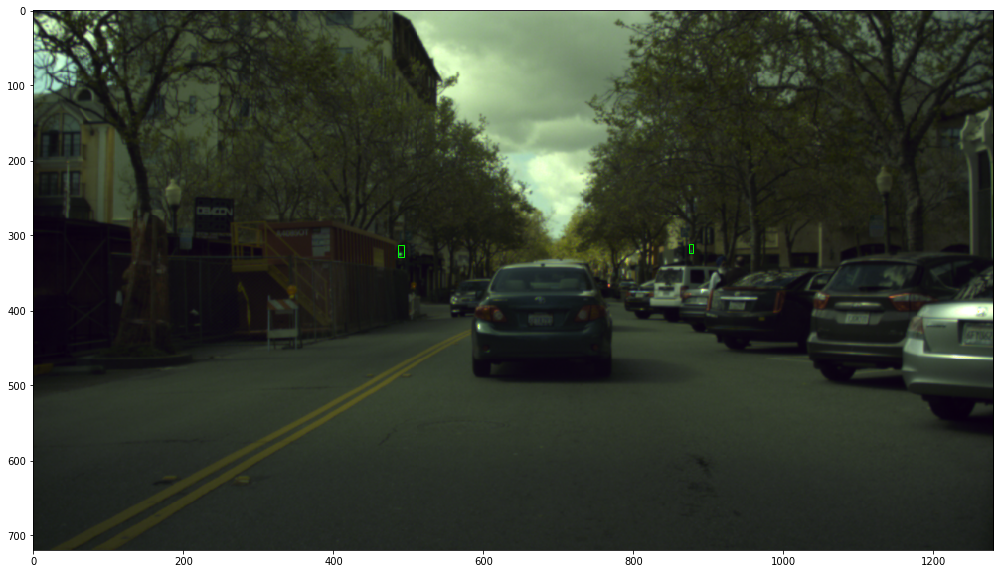

#########################################TFrecord Information#########################################
Name of the TFrecord: b'/workspace/label_files/rgb/test/35446.png'
The shape of the image is: (720, 1280, 3)
The are 1 boxes in the image:
The are 1 objects in the image:
[2]


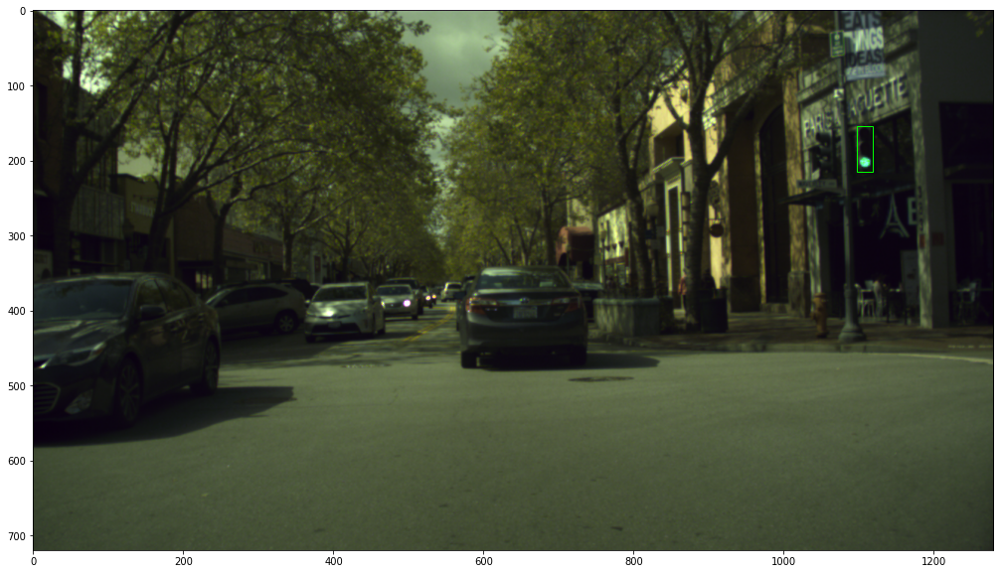

#########################################TFrecord Information#########################################
Name of the TFrecord: b'/workspace/label_files/rgb/test/28808.png'
The shape of the image is: (720, 1280, 3)
The are 1 boxes in the image:
The are 1 objects in the image:
[4]


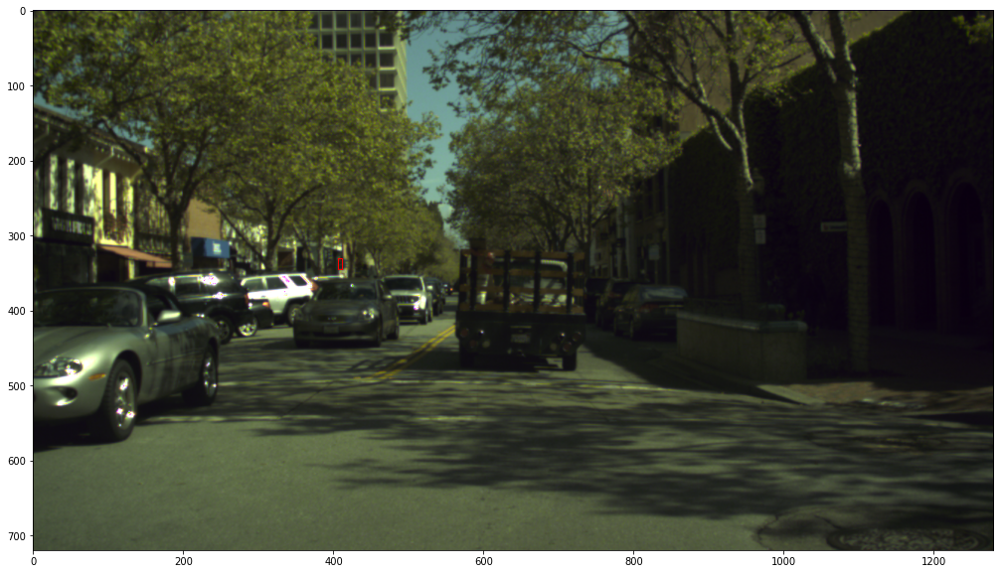

In [53]:
for batches in test_tfrecord.take(15):
    display_instances(batches)